In [1]:
import csv

reader = csv.DictReader(open('bigram_to_ngram.csv', 'r'))
bi_to_n = []

for line in reader:
    bi_to_n.append(line)

bi_to_n

[{'bigram': 'learning performance',
  'bigram doc_count': '5',
  'bigram score': '0.028144914884329984',
  'n-gram (containing bigram)': 'term learning performance',
  'n-gram doc_count': '1',
  'n-gram score': '0.042776080314273233'},
 {'bigram': 'learning performance',
  'bigram doc_count': '5',
  'bigram score': '0.028144914884329984',
  'n-gram (containing bigram)': 'learning performance guarantee',
  'n-gram doc_count': '1',
  'n-gram score': '0.043649061545176775'},
 {'bigram': 'learning performance',
  'bigram doc_count': '5',
  'bigram score': '0.028144914884329984',
  'n-gram (containing bigram)': 'superior learning performance',
  'n-gram doc_count': '1',
  'n-gram score': '0.04539502400698384'},
 {'bigram': 'conditional independence',
  'bigram doc_count': '2',
  'bigram score': '0.026189436927106065',
  'n-gram (containing bigram)': 'conditional independence inherited',
  'n-gram doc_count': '1',
  'n-gram score': '0.04714098646879092'},
 {'bigram': 'conditional independenc

In [10]:
keywords = set()

for rel in bi_to_n:
    keywords.add((rel['bigram'], rel['bigram score'], rel['bigram doc_count']))
    keywords.add((rel['n-gram (containing bigram)'], rel['n-gram score'], rel['n-gram doc_count']))
    
keywords

{('whose size ranges', '0.04714098646879092', '1'),
 ('convex relaxation techniques', '0.04714098646879092', '1'),
 ('mab algorithms', '0.036665211697948494', '1'),
 ('overlapping groups', '0.0202968136185072', '4'),
 ('efficient inference', '0.081672244046753', '9'),
 ('sampling strategy', '0.02487996508075076', '1'),
 ('binary tree', '0.020951549541684853', '3'),
 ('dimensional spaces', '0.020951549541684853', '1'),
 ('eliciting private data', '0.42426887821911824', '1'),
 ('training methods', '0.07840202864209848', '3'),
 ('linear networks', '0.12169358358795286', '5'),
 ('higher predictive accuracy', '0.039284155390659097', '1'),
 ('general multiclass losses', '0.42426887821911824', '1'),
 ('robotic control', '0.020951549541684853', '1'),
 ('multidimensional functional space', '0.04714098646879092', '1'),
 ('distributed minimization algorithms', '0.04452204277608031', '1'),
 ('bandit convex optimization', '0.044522042776080316', '3'),
 ('correlation learning architecture', '0.42426

In [11]:
len(keywords)

17516

In [4]:
import numpy as np
import pickle

def load_file(file):
    with open(file, 'rb') as f:
        return pickle.load(f)
    
idx_to_word = load_file("idx_to_word.pkl")
word_to_idx = load_file("word_to_idx.pkl")
vectors = np.load("output.npy")

def get_word_vector(word):
    idx = word_to_idx[word]
    return vectors[idx]

def get_word_at_index(index):
    return idx_to_word[index]

In [13]:
#get top 1000 keyword vectors by score

#quicksort tuples into a list by score
by_score = sorted(keywords, key = lambda tup: tup[1], reverse=True)

by_score

[('deep neural networks', '0.5799650807507637', '6'),
 ('multivariate laplace prior', '0.4714098646879092', '1'),
 ('bayesian deep learning', '0.46879092099519853', '1'),
 ('supervised binary hashing', '0.46879092099519853', '1'),
 ('learning distributed representations', '0.467917939764295', '1'),
 ('calcium imaging data', '0.4670449585333915', '1'),
 ('lifted inference rules', '0.46617197730248794', '1'),
 ('partially labeled data', '0.4465298996071584', '2'),
 ('learning multiple tasks', '0.43683980794412913', '3'),
 ('gaussian process models', '0.4242688782191183', '8'),
 ('eliciting private data', '0.42426887821911824', '1'),
 ('general multiclass losses', '0.42426887821911824', '1'),
 ('correlation learning architecture', '0.42426887821911824', '1'),
 ('global sensitivity analysis', '0.42426887821911824', '1'),
 ('approximate supermodularity bounds', '0.42426887821911824', '1'),
 ('designing smoothing functions', '0.42426887821911824', '1'),
 ('recurrent ladder networks', '0.4242

In [17]:
vecs_score = []
for i in range(1000):
    vecs_score.append(get_word_vector(by_score[i][0]))

vecs_score

[array([-0.01539286, -0.05659478, -0.05254304,  0.06337025,  0.02836691,
        -0.02564323, -0.00437385, -0.0010515 , -0.00743985,  0.05282891,
         0.04968159, -0.05790412, -0.03054446,  0.04704393,  0.012264  ,
        -0.02626009,  0.00290342, -0.03951849,  0.07489464, -0.00470813,
        -0.05662378, -0.06314486, -0.05513469,  0.07124938,  0.00752878,
        -0.04653249, -0.00053023, -0.06639429, -0.06041424,  0.03210362,
         0.03086305,  0.00428539,  0.01950967, -0.07170808,  0.07075027,
        -0.00058844, -0.00295674, -0.01625127,  0.02562533, -0.05900659,
         0.0279018 ,  0.06109023, -0.05267326,  0.07353532, -0.06762577,
         0.02810514,  0.01430238,  0.00624042,  0.0482973 , -0.06959277,
         0.0320008 , -0.04525837,  0.07607249, -0.07190072,  0.03810492,
         0.02451175,  0.04377784,  0.0133007 ,  0.05698058, -0.00014263,
         0.01988574,  0.05492067, -0.02531975,  0.0237649 , -0.05080697,
        -0.06206506,  0.04583654,  0.04595884,  0.0

In [19]:
#get top 1000 keyword vectors by doc_count

by_doc_count = sorted(keywords, key = lambda tup:tup[2], reverse=True)

by_doc_count

[('efficient inference', '0.081672244046753', '9'),
 ('first algorithm', '0.03724719918521752', '9'),
 ('probability distribution', '0.030651340996168577', '9'),
 ('sample size', '0.06799553809593092', '9'),
 ('fundamental problem', '0.07949949076094864', '9'),
 ('classification tasks', '0.027644405645278623', '9'),
 ('domain adaptation', '0.1480188175954217', '9'),
 ('empirical studies', '0.03317328677433436', '9'),
 ('cost function', '0.073912410883166', '9'),
 ('bayesian approach', '0.11251758087201126', '9'),
 ('superior performance', '0.05169988845239827', '9'),
 ('learning curves', '0.16994034628255492', '9'),
 ('exponential family', '0.07614336291769727', '9'),
 ('observed data', '0.04718948542606334', '9'),
 ('regularization parameter', '0.033270284688879194', '9'),
 ('computationally efficient', '0.06547359231776517', '9'),
 ('learning theory', '0.07973228575585625', '9'),
 ('kernel matrix', '0.04818856394587516', '9'),
 ('convex optimization problem', '0.10519423832387603', '

In [20]:
vecs_doc_count =  []

for i in range(1000):
    vecs_doc_count.append(get_word_vector(by_doc_count[i][0]))
    
vecs_doc_count

[array([ 0.02541761, -0.02627461, -0.05252372,  0.0664525 ,  0.05532645,
        -0.03151961, -0.03143279, -0.02788145, -0.07893399, -0.03296718,
         0.03226059, -0.0722373 , -0.06065973, -0.05233891,  0.00102835,
        -0.02684538, -0.02827594,  0.03141067,  0.05875647, -0.04190542,
        -0.05929848, -0.06410629, -0.06339527,  0.06027528, -0.02198174,
        -0.01630806, -0.0308405 , -0.08322827, -0.02153919,  0.04000691,
         0.05097866,  0.00540796,  0.01067948, -0.04463715,  0.06412143,
         0.0196238 ,  0.02284872,  0.01896746,  0.00939722, -0.02107582,
         0.05243522, -0.05644633, -0.01382465,  0.05531029, -0.02134491,
        -0.01226401,  0.00957248,  0.01423023,  0.005232  , -0.04632705,
         0.03762634, -0.01309011,  0.08332071, -0.0631443 ,  0.06444231,
         0.00625515,  0.06469596,  0.02199799,  0.01165036, -0.02335491,
        -0.02003608,  0.02876221, -0.00263737,  0.01124399, -0.07186712,
        -0.05379803,  0.06048746,  0.00493197,  0.0

In [21]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
%matplotlib inline

In [23]:
xy_score = TSNE().fit_transform(vecs_score)

len(xy_score)

1000

In [25]:
xy_doc_count = TSNE().fit_transform(vecs_doc_count)

xy_doc_count

array([[  4.280517 ,  23.524818 ],
       [  9.936433 ,  31.474384 ],
       [  2.5280023, -15.988809 ],
       ...,
       [  5.0739098, -35.2047   ],
       [  5.9122233,  -3.6816216],
       [ 40.237125 , -12.943461 ]], dtype=float32)

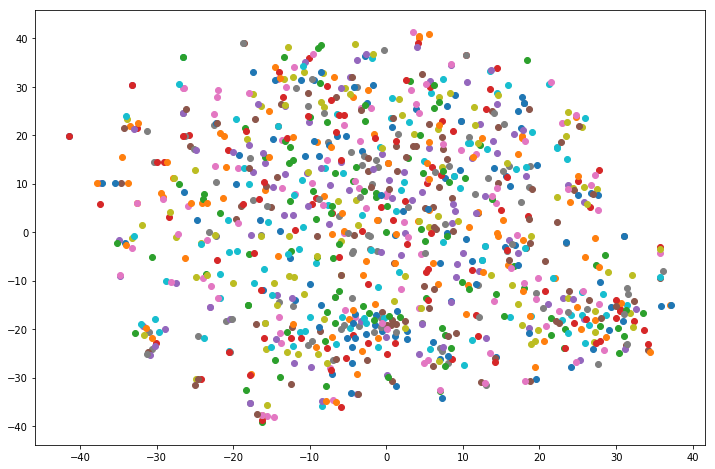

In [35]:
plt.figure(figsize=(12,8))
for i in range(1000):
#    plt.annotate(by_score[i][0],
#                xy = (xy_score[i][0], xy_score[i][1]),
#                xytext = (3,1),
#                textcoords='offset points',
#                ha = 'right',
#                va = 'bottom')
    plt.scatter(xy_score[i][0], xy_score[i][1])

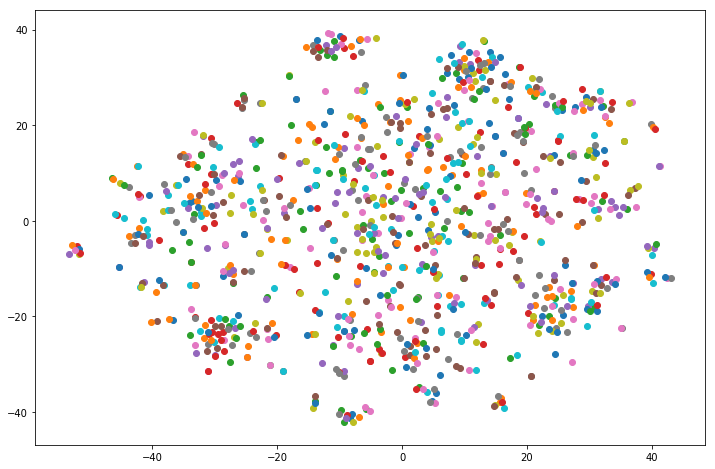

In [31]:
#plotting by doc_counts

plt.figure(figsize=(12,8))
for i in range(1000):
    plt.scatter(xy_doc_count[i][0], xy_doc_count[i][1])

In [36]:
total = []

for word in keywords:
    total.append(get_word_vector(word[0]))
    
total

[array([-0.01740451, -0.01111216, -0.048287  ,  0.00222373,  0.00905638,
        -0.07839384,  0.00322126, -0.0304029 , -0.06325894, -0.00339936,
        -0.07391454, -0.08154117,  0.00169205, -0.03069157, -0.03259246,
         0.00346467, -0.023552  ,  0.03559247,  0.06790873,  0.0561537 ,
         0.01683744, -0.01074712, -0.03111637,  0.0076196 ,  0.07156104,
        -0.10083508, -0.08781103, -0.02599203, -0.03535504, -0.00311002,
        -0.07259902,  0.03799422, -0.00817403, -0.01562286,  0.10501802,
         0.06443302, -0.0486109 , -0.06103116,  0.0149397 , -0.00351136,
         0.00192106,  0.01967415,  0.00417759, -0.00347326,  0.04992076,
         0.04193666, -0.05747533,  0.06898241,  0.0202819 ,  0.03037886,
        -0.01441681,  0.0046545 ,  0.07989569, -0.05533456,  0.02919577,
        -0.03378576,  0.06033251,  0.03094407, -0.04213272, -0.00724844,
        -0.02111164, -0.05960563,  0.03458311, -0.00887079, -0.01404887,
        -0.04741208,  0.02859567,  0.01697776,  0.0

In [ ]:
xy_total = TSNE().fit_transform(total)

plt.figure(figsize=(12,8))

for pt in xy_total:
    plt.scatter(pt[0], pt[1])